## Figure 4 code
Elena Savidge
<br>
31 Oct 2024

In [1]:
# import packages
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import cartopy.crs as ccrs
import matplotlib.font_manager as fm
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
from skimage import exposure
from shapely.geometry import Point, Polygon
import geopandas as gpd
import pyproj
from pyproj import Proj, transform, CRS
import h5py

/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/pyproj/__init__.py:89: UserWarning: pyproj unable to set database path.
  _pyproj_global_context_initialize()


In [2]:
# need this line for pyproj to work on my machine
pyproj.datadir.set_data_dir('/opt/anaconda3/envs/polyarea/share/proj') 

## Read grounding line

In [3]:
# Define your points and create a bounding box polygon
p1 = Point(-110, -70.5)
p2 = Point(-111.7, -75.4)
p3 = Point(-98.0, -75.4)
p4 = Point(-99.5, -70.5)

# Define the bounding box CRS
crs = "EPSG:4326"  # Adjust this based on your data's CRS
bb_polygon = Polygon([p1, p2, p3, p4])
map_extent = gpd.GeoDataFrame(geometry=[bb_polygon], crs=crs)

# Read in the coastline with a defined CRS
coastline = '../add_coastline_high_res_line_v7_4.shp'  #version 7.4 is updated
shelf = gpd.read_file(coastline)

# Make sure both GeoDataFrames have the same CRS
shelf = shelf.to_crs(crs)

# Check the intersection
intersection = map_extent.intersects(shelf.unary_union)
print("Intersection:", intersection)

# Clip with the same CRS
shelf_clip = gpd.clip(shelf, map_extent)
shelf_clip = shelf_clip[~shelf_clip.is_empty]
# land = shelf_clip.loc[shelf_clip['surface'] == 'land']
# ice = shelf_clip.loc[shelf_clip['surface'] == 'ice shelf']
GL = shelf_clip.loc[shelf_clip['surface'] == 'grounding line']

# Print lengths to verify
print("Length of original shelf:", len(shelf))
print("Length of clipped shelf:", len(shelf_clip))
# print("Length of land:", len(land))
# print("Length of ice:", len(ice))
print("Length of GL:", len(GL))

Intersection: 0    True
dtype: bool
Length of original shelf: 30663
Length of clipped shelf: 212
Length of GL: 43


## Read strain rate data

In [4]:
f = h5py.File('../../PhD_Ch2/PIG_strains.h5', 'r')

In [5]:
list(f.keys())

['dilatation', 'effective', 'exx', 'exy', 'eyy', 'tdec', 'x', 'y']

In [6]:
# get variables
effective_strain = f['effective']
dilatation = f['dilatation'] # a change in the volume of material due to the application of load
exx = f['exx']
exy = f['exy']
eyy = f['eyy']
time = f['tdec'] 

In [7]:
# get bounds of the data
x = f['x']
y = f['y']
min(x),max(x),min(y),max(y)

(-1651125.0, -1545125.0, -345875.0, -177625.0)

In [8]:
# and define them 
upper_left_str = (-1651125,-177625)
upper_right_str = (-1545125,-177625)
lower_left_str = (-1651125,-345875)
lower_right_str = (-1545125,-345875)

upper_left_str,upper_right_str,lower_left_str,lower_right_str

((-1651125, -177625),
 (-1545125, -177625),
 (-1651125, -345875),
 (-1545125, -345875))

In [9]:
# check crs
# For Landsat image
with rasterio.open('../Landsat/20190130/rgb_individual/LC08_L1GT_001113_20190130_20201016_02_T2_B4.TIF') as src_ls:
    print(src_ls.crs)  # Check CRS of Landsat image
    

PROJCS["PS         WGS84",GEOGCS["WGS 84",DATUM["World Geodetic System 1984",SPHEROID["WGS 84",6378137,298.257223563]],PRIMEM["Greenwich",0],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]]],PROJECTION["Polar_Stereographic"],PARAMETER["latitude_of_origin",-71],PARAMETER["central_meridian",0],PARAMETER["false_easting",0],PARAMETER["false_northing",0],UNIT["metre",1],AXIS["Easting",NORTH],AXIS["Northing",NORTH]]


In [10]:
# so that we can match background and overlay
projection2 = ccrs.SouthPolarStereo()
# get corners in desired projection
ul_lon_strain, ul_lat_strain = projection2.transform_point(upper_left_str[0], upper_left_str[1], src_ls.crs)
ur_lon_strain, ur_lat_strain = projection2.transform_point(upper_right_str[0], upper_right_str[1], src_ls.crs)
ll_lon_strain, ll_lat_strain = projection2.transform_point(lower_left_str[0], lower_left_str[1], src_ls.crs)
lr_lon_strain, lr_lat_strain = projection2.transform_point(lower_right_str[0], lower_right_str[1], src_ls.crs)

In [11]:
#lr_lon_strain

## Read Sentinel-2 scenes and overlay strain rates

In [12]:
# This tile has CRS info (downloaded from USGS Earth Explorer as .tif file), It is the same tile and CRS as new download from ESA which delivered .jpg files.
file_path = '../PIG_sentinel2/L1C_T14CMB_A015809_20200316T145252.tif'

# Normalize each band independently
def normalize_band(band):
    band_min = band.min()
    band_max = band.max()
    return ((band - band_min) / (band_max - band_min) * 255).astype('uint8')

# Open the single band
with rasterio.open(file_path) as file:
    # Read each band
    red_band = file.read(1)
    green_band = file.read(2)
    blue_band = file.read(3)

    # Normalize each band
    red_band_normalized = normalize_band(red_band)
    green_band_normalized = normalize_band(green_band)
    blue_band_normalized = normalize_band(blue_band)

    # Stack the bands into an RGB image
    rgb_image = np.dstack((red_band_normalized, green_band_normalized, blue_band_normalized))

    # Get the geospatial transformation matrix
    transform = file.transform  # Assumes all bands share the same transform

    # Specify the South Polar Stereographic projection
    projection = ccrs.SouthPolarStereo(central_longitude=-99.0)  #get central lon from metadata

    # Calculate the geographic coordinates of the four corners
    width, height = file.width, file.height
    upper_left = transform * (0, 0)
    upper_right = transform * (width, 0)
    lower_left = transform * (0, height)
    lower_right = transform * (width, height)

    # Get corners in the desired projection
    ul_lon, ul_lat = projection.transform_point(upper_left[0], upper_left[1], file.crs)
    ur_lon, ur_lat = projection.transform_point(upper_right[0], upper_right[1], file.crs)
    ll_lon, ll_lat = projection.transform_point(lower_left[0], lower_left[1], file.crs)
    lr_lon, lr_lat = projection.transform_point(lower_right[0], lower_right[1], file.crs)


In [13]:
file.crs

ERROR 1: PROJ: proj_identify: /opt/anaconda3/share/proj/proj.db lacks DATABASE.LAYOUT.VERSION.MAJOR / DATABASE.LAYOUT.VERSION.MINOR metadata. It comes from another PROJ installation.


CRS.from_wkt('PROJCS["WGS 84 / UTM zone 14S",GEOGCS["WGS 84",DATUM["World Geodetic System 1984",SPHEROID["WGS 84",6378137,298.257223563]],PRIMEM["Greenwich",0],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]]],PROJECTION["Transverse_Mercator"],PARAMETER["latitude_of_origin",0],PARAMETER["central_meridian",-99],PARAMETER["scale_factor",0.9996],PARAMETER["false_easting",500000],PARAMETER["false_northing",10000000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]')

## 7 March 2018

In [14]:
#7th March 2018 is approximately 2018.1808 in decimal years
time[110]

2018.1739747844697

In [15]:
# sentinel2: blue (B2), green (B3), red (B4)

red_path= '../PIG_sentinel2/20180307/T14CMB_20180307T145249_B04.jp2'
green_path= '../PIG_sentinel2/20180307/T14CMB_20180307T145249_B03.jp2'
blue_path= '../PIG_sentinel2/20180307/T14CMB_20180307T145249_B02.jp2'


# Normalize each band independently
def normalize_band(band):
    band_min = band.min()
    band_max = band.max()
    return ((band - band_min) / (band_max - band_min) * 255).astype('uint8')

# Open the single band
with rasterio.open(red_path) as rr, rasterio.open(green_path) as gg, rasterio.open(blue_path) as bb:
    # Read each band
    red_band = rr.read(1)
    green_band = gg.read(1)
    blue_band = bb.read(1)

    # Normalize each band
    red_band_normalized = normalize_band(red_band)
    green_band_normalized = normalize_band(green_band)
    blue_band_normalized = normalize_band(blue_band)

    # Stack the bands into an RGB image
    rgb_image = np.dstack((red_band_normalized, green_band_normalized, blue_band_normalized))

    # Get the geospatial transformation matrix
    transform = file.transform  # Assumes all bands share the same transform

    # Specify the South Polar Stereographic projection
    projection = ccrs.SouthPolarStereo(central_longitude=-99.0)  #get central lon from metadata

    # Calculate the geographic coordinates of the four corners
    width, height = file.width, file.height
    upper_left = transform * (0, 0)
    upper_right = transform * (width, 0)
    lower_left = transform * (0, height)
    lower_right = transform * (width, height)

    # Get corners in the desired projection
    ul_lon, ul_lat = projection.transform_point(upper_left[0], upper_left[1], file.crs)
    ur_lon, ur_lat = projection.transform_point(upper_right[0], upper_right[1], file.crs)
    ll_lon, ll_lat = projection.transform_point(lower_left[0], lower_left[1], file.crs)
    lr_lon, lr_lat = projection.transform_point(lower_right[0], lower_right[1], file.crs)


In [16]:
# Apply higher contrast stretching to each color channel
# It calculates the 1st and 99th percentiles of pixel values in each channel and stretches 
# the pixel values to cover the full range between these percentiles
def contrast_stretching(image):
    p1, p95 = np.percentile(image, (1, 95))  # Adjust the percentiles to control the contrast
    return exposure.rescale_intensity(image, in_range=(p1, p95))

red_band_stretched = contrast_stretching(rgb_image[:, :, 0])
green_band_stretched = contrast_stretching(rgb_image[:, :, 1])
blue_band_stretched = contrast_stretching(rgb_image[:, :, 2])

# Apply gamma correction to each color channel
# It applies a power-law transformation to the pixel values, effectively adjusting the brightness of the image.
#A gamma value of 3.5 is used in the code, which has the effect of darkening shadows and enhancing mid-tones and highlights.
def gamma_correction(image, gamma=2):
    return exposure.adjust_gamma(image, gamma)

red_band_corrected = gamma_correction(red_band_stretched)
green_band_corrected = gamma_correction(green_band_stretched)
blue_band_corrected = gamma_correction(blue_band_stretched)

# Stack the corrected channels back into an RGB image
rgb_image_corrected = np.stack((red_band_corrected, green_band_corrected, blue_band_corrected), axis=-1)

In [26]:
# #llcrnrlat=-75.4;urcrnrlat=-74.9;llcrnrlon=-102;urcrnrlon=-99.5
# llcrnrlat=-75.34;urcrnrlat=-74.8;llcrnrlon=-102.3;urcrnrlon=-99
# # Create the plot with the specified CRS
# fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': projection})

# # Set the extent
# ax.set_extent([llcrnrlon, urcrnrlon, llcrnrlat, urcrnrlat], crs=ccrs.PlateCarree())

# # Display the Landsat image with improved brightness, higher contrast, and gamma correction
# data = ax.imshow(rgb_image_corrected, extent=(ll_lon, ur_lon, ll_lat, ur_lat), origin='upper',transform=projection)
# strain = ax.imshow(effective_strain[110,:,:], extent=(ll_lon_strain, ur_lon_strain, ll_lat_strain, ur_lat_strain),vmin =0, vmax = 1.5, cmap = 'Reds',transform=projection2,alpha=0.4)

# # Add gridlines with the correct orientation
# gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, xlocs=[-102, -101, -100, -99], ylocs=[-74.8, -75, -75.2, -74, -73, -72], color='k', linestyle=':',linewidth=1.5)
# gl.top_labels = gl.right_labels = False  # Turn off top and right labels

# # Colorbar
# cb = plt.colorbar(strain, fraction=0.04, pad=0.03)
# cb.set_label('Strain', fontsize=14, labelpad=5)

# fontprops = fm.FontProperties(size=20)
# scalebar = AnchoredSizeBar(ax.transData,
#                            10000, '10 km', 'lower left',
#                            pad=0.5,
#                            color='k',
#                            frameon=False,
#                            size_vertical=250,
#                            fill_bar=True,
#                            sep=3.5,
#                            fontproperties=fontprops)
# ax.add_artist(scalebar)

# # Turn off axis
# #ax.axis('off')

# plt.show()

## Zoom

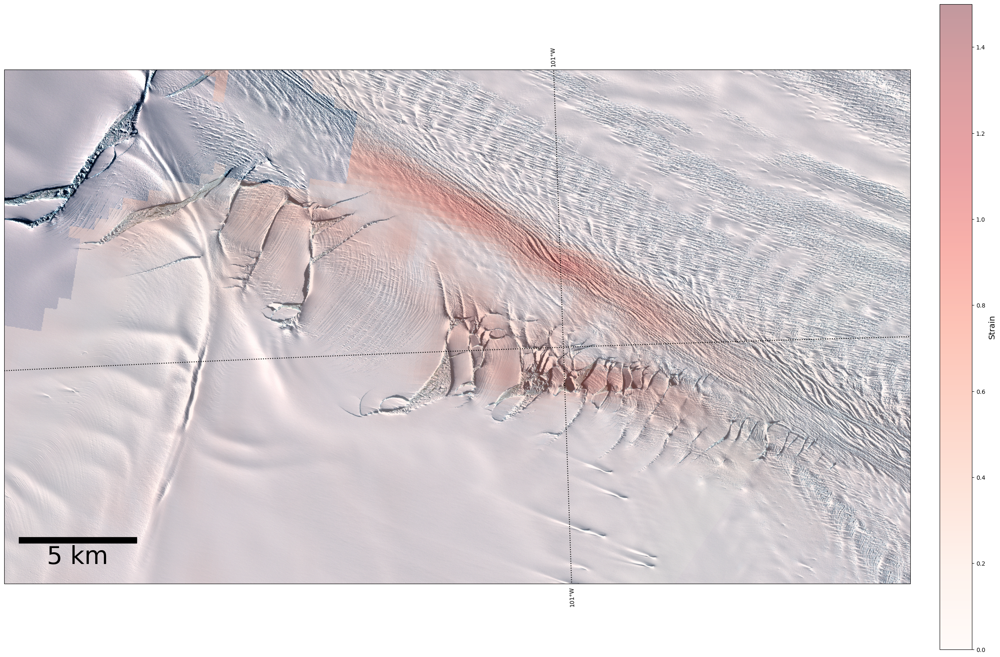

In [18]:
# Plot
#llcrnrlat=-75.4;urcrnrlat=-74.9;llcrnrlon=-102;urcrnrlon=-99.5
#llcrnrlat=-75.28;urcrnrlat=-75.1;llcrnrlon=-102;urcrnrlon=-99.5
llcrnrlat=-75.28;urcrnrlat=-75.1;llcrnrlon=-101.8;urcrnrlon=-100.5
llcrnrlat=-75.28;urcrnrlat=-75.1;llcrnrlon=-101.8;urcrnrlon=-100.5
# Create the plot with the specified CRS
fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': projection})

# Set the extent
ax.set_extent([llcrnrlon, urcrnrlon, llcrnrlat, urcrnrlat], crs=ccrs.PlateCarree())

# Display the Landsat image with improved brightness, higher contrast, and gamma correction
data = ax.imshow(rgb_image_corrected, extent=(ll_lon, ur_lon, ll_lat, ur_lat), origin='upper',transform=projection)
strain = ax.imshow(effective_strain[110,:,:], extent=(ll_lon_strain, ur_lon_strain, ll_lat_strain, ur_lat_strain),vmin =0, vmax = 1.5, cmap = 'Reds',transform=projection2,alpha=0.4)

# Add gridlines with the correct orientation
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, xlocs=[-101], ylocs=[-75.2], color='k', linestyle=':',linewidth=1.5)
# gl.top_labels = gl.right_labels = False  # Turn off top and right labels

# Colorbar
cb = plt.colorbar(strain, fraction=0.04, pad=0.03)
cb.set_label('Strain', fontsize=14, labelpad=5)

fontprops = fm.FontProperties(size=42)
scalebar = AnchoredSizeBar(ax.transData,
                           5000, '5 km', 'lower left',
                           pad=0.5,
                           color='k',
                           frameon=False,
                           size_vertical=250,
                           fill_bar=True,
                           sep=3.5,
                           fontproperties=fontprops)
ax.add_artist(scalebar)

# Turn off axis
#ax.axis('off')

#plt.show()
#plt.savefig('strainrate-panela.png', format='png', dpi=400)


## 23 Dec 2019

In [19]:
#23rd December 2019 is approximately 2019.9781 in decimal years.
time[174]

2019.9959436752592

In [20]:
# sentinel2: blue (B2), green (B3), red (B4)

# red_path= '../PIG_sentinel2/20200201/T14CMB_20200201T151249_B04_10m.jp2'
# green_path= '../PIG_sentinel2/20200201/T14CMB_20200201T151249_B03_10m.jp2'
# blue_path= '../PIG_sentinel2/20200201/T14CMB_20200201T151249_B02_10m.jp2'

red_path= '../PIG_sentinel2/20191223/T14CMB_20191223T151259_B04.jp2'
green_path= '../PIG_sentinel2/20191223/T14CMB_20191223T151259_B03.jp2'
blue_path= '../PIG_sentinel2/20191223/T14CMB_20191223T151259_B02.jp2'

# Normalize each band independently
def normalize_band(band):
    band_min = band.min()
    band_max = band.max()
    return ((band - band_min) / (band_max - band_min) * 255).astype('uint8')

# Open the single band
with rasterio.open(red_path) as rr, rasterio.open(green_path) as gg, rasterio.open(blue_path) as bb:
    # Read each band
    red_band = rr.read(1)
    green_band = gg.read(1)
    blue_band = bb.read(1)

    # Normalize each band
    red_band_normalized = normalize_band(red_band)
    green_band_normalized = normalize_band(green_band)
    blue_band_normalized = normalize_band(blue_band)

    # Stack the bands into an RGB image
    rgb_image = np.dstack((red_band_normalized, green_band_normalized, blue_band_normalized))

    # Get the geospatial transformation matrix
    transform = file.transform  # Assumes all bands share the same transform

    # Specify the South Polar Stereographic projection
    projection = ccrs.SouthPolarStereo(central_longitude=-99.0)  #get central lon from metadata

    # Calculate the geographic coordinates of the four corners
    width, height = file.width, file.height
    upper_left = transform * (0, 0)
    upper_right = transform * (width, 0)
    lower_left = transform * (0, height)
    lower_right = transform * (width, height)

    # Get corners in the desired projection
    ul_lon, ul_lat = projection.transform_point(upper_left[0], upper_left[1], file.crs)
    ur_lon, ur_lat = projection.transform_point(upper_right[0], upper_right[1], file.crs)
    ll_lon, ll_lat = projection.transform_point(lower_left[0], lower_left[1], file.crs)
    lr_lon, lr_lat = projection.transform_point(lower_right[0], lower_right[1], file.crs)


In [21]:
# Apply higher contrast stretching to each color channel
# It calculates the 1st and 99th percentiles of pixel values in each channel and stretches 
# the pixel values to cover the full range between these percentiles
def contrast_stretching(image):
    p1, p95 = np.percentile(image, (1, 95))  # Adjust the percentiles to control the contrast
    return exposure.rescale_intensity(image, in_range=(p1, p95))

red_band_stretched = contrast_stretching(rgb_image[:, :, 0])
green_band_stretched = contrast_stretching(rgb_image[:, :, 1])
blue_band_stretched = contrast_stretching(rgb_image[:, :, 2])

# Apply gamma correction to each color channel
# It applies a power-law transformation to the pixel values, effectively adjusting the brightness of the image.
#A gamma value of 3.5 is used in the code, which has the effect of darkening shadows and enhancing mid-tones and highlights.
def gamma_correction(image, gamma=2):
    return exposure.adjust_gamma(image, gamma)

red_band_corrected = gamma_correction(red_band_stretched)
green_band_corrected = gamma_correction(green_band_stretched)
blue_band_corrected = gamma_correction(blue_band_stretched)

# Stack the corrected channels back into an RGB image
rgb_image_corrected = np.stack((red_band_corrected, green_band_corrected, blue_band_corrected), axis=-1)

In [27]:
# #llcrnrlat=-75.4;urcrnrlat=-74.9;llcrnrlon=-102;urcrnrlon=-99.5
# llcrnrlat=-75.34;urcrnrlat=-74.8;llcrnrlon=-102.3;urcrnrlon=-99
# # Create the plot with the specified CRS
# fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': projection})

# # Set the extent
# ax.set_extent([llcrnrlon, urcrnrlon, llcrnrlat, urcrnrlat], crs=ccrs.PlateCarree())

# # Display the Landsat image with improved brightness, higher contrast, and gamma correction
# data = ax.imshow(rgb_image_corrected, extent=(ll_lon, ur_lon, ll_lat, ur_lat), origin='upper',transform=projection)
# strain = ax.imshow(effective_strain[174,:,:], extent=(ll_lon_strain, ur_lon_strain, ll_lat_strain, ur_lat_strain),vmin =0, vmax = 1.5, cmap = 'Reds',transform=projection2,alpha=0.4)

# # Add gridlines with the correct orientation
# gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, xlocs=[-102, -101, -100, -99], ylocs=[-75, -75.2, -73, -72], color='k', linestyle=':',linewidth=1.5)
# gl.top_labels = gl.right_labels = False  # Turn off top and right labels

# # Colorbar
# cb = plt.colorbar(strain, fraction=0.04, pad=0.03)
# cb.set_label('Strain', fontsize=14, labelpad=5)

# fontprops = fm.FontProperties(size=20)
# scalebar = AnchoredSizeBar(ax.transData,
#                            10000, '10 km', 'lower left',
#                            pad=0.5,
#                            color='k',
#                            frameon=False,
#                            size_vertical=250,
#                            fill_bar=True,
#                            sep=3.5,
#                            fontproperties=fontprops)
# ax.add_artist(scalebar)

# # Turn off axis
# #ax.axis('off')

# plt.show()


## Zoom

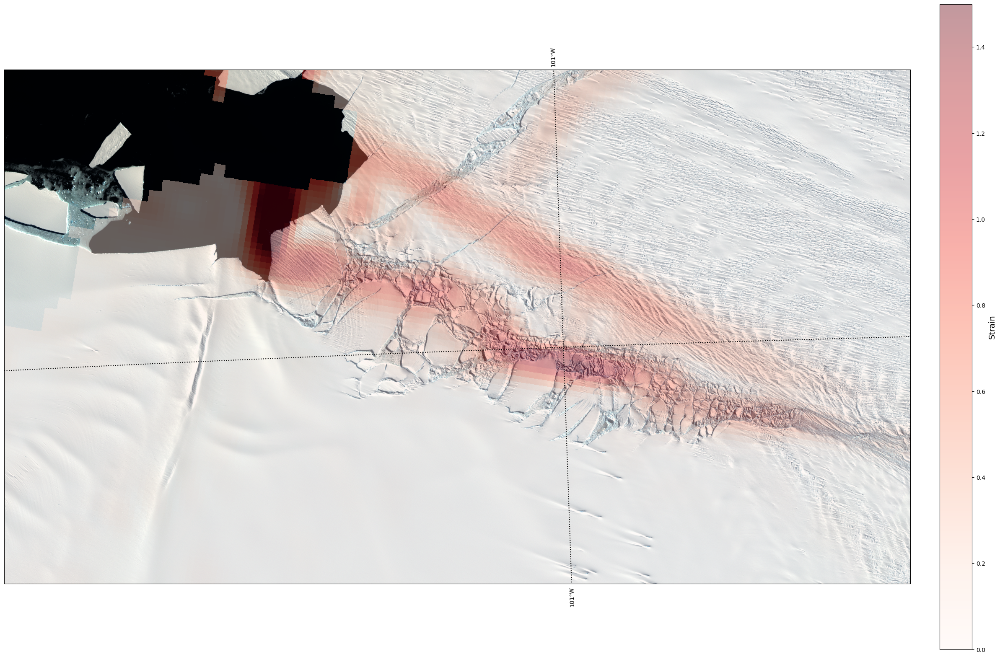

In [23]:
#llcrnrlat=-75.4;urcrnrlat=-74.9;llcrnrlon=-102;urcrnrlon=-99.5
#llcrnrlat=-75.28;urcrnrlat=-75.1;llcrnrlon=-102;urcrnrlon=-99.5
llcrnrlat=-75.28;urcrnrlat=-75.1;llcrnrlon=-101.8;urcrnrlon=-100.5
# Create the plot with the specified CRS
fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': projection})

# Set the extent
ax.set_extent([llcrnrlon, urcrnrlon, llcrnrlat, urcrnrlat], crs=ccrs.PlateCarree())

# Display the Landsat image with improved brightness, higher contrast, and gamma correction
data = ax.imshow(rgb_image_corrected, extent=(ll_lon, ur_lon, ll_lat, ur_lat), origin='upper',transform=projection)
strain = ax.imshow(effective_strain[174,:,:], extent=(ll_lon_strain, ur_lon_strain, ll_lat_strain, ur_lat_strain),vmin =0, vmax = 1.5, cmap = 'Reds',transform=projection2,alpha=0.4)

# Add gridlines with the correct orientation
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, xlocs=[-101], ylocs=[-75.2], color='k', linestyle=':',linewidth=1.5)
# gl.top_labels = gl.right_labels = False  # Turn off top and right labels

# Colorbar
cb = plt.colorbar(strain, fraction=0.04, pad=0.03)
cb.set_label('Strain', fontsize=14, labelpad=5)

# fontprops = fm.FontProperties(size=35)
# scalebar = AnchoredSizeBar(ax.transData,
#                            5000, '5 km', 'lower left',
#                            pad=0.5,
#                            color='k',
#                            frameon=False,
#                            size_vertical=250,
#                            fill_bar=True,
#                            sep=3.5,
#                            fontproperties=fontprops)
# ax.add_artist(scalebar)

# Turn off axis
#ax.axis('off')

plt.show()
#plt.savefig('strainrate-panelb.png', format='png', dpi=400)


## Strain rate time series

([], [])

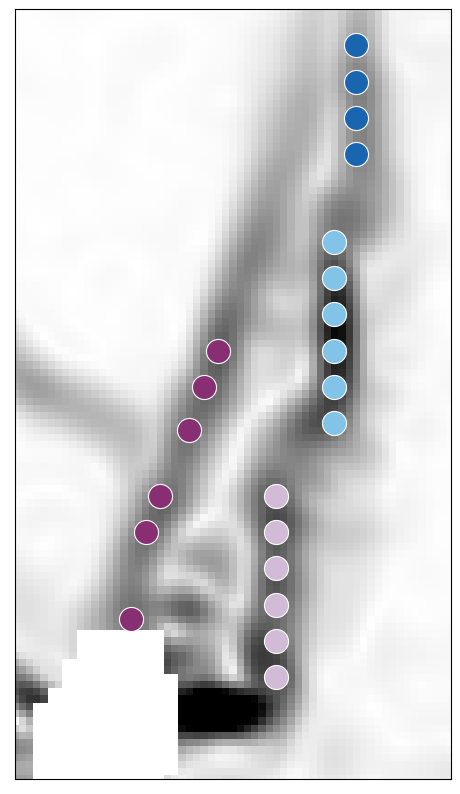

In [24]:
# Sampling locations

plt.figure(figsize=(8,10))
plt.imshow(effective_strain[180,:,:], vmin = 0, vmax = 1.5, cmap = 'binary')
plt.xlim([215,275]);plt.ylim([584,478])
#plt.title(time[0][199])

# Colorbar
# cb = plt.colorbar(orientation='horizontal',pad=0.02, fraction=0.027)
# cb.ax.tick_params(labelsize=18) 
#plt.colorbar(fraction=0.04, pad=0.03) 

# plt.scatter(262,485,c = '#1965B0',edgecolor='w',linewidth=0.8, s=300)
# plt.scatter(262,490,c = '#1965B0',edgecolor='w',linewidth=0.8,s=300)
# plt.scatter(262,495,c = '#1965B0',edgecolor='w',linewidth=0.8,s=300)
# plt.scatter(262,500,c = '#1965B0',edgecolor='w',linewidth=0.8,s=300)

plt.scatter(262,483,c = '#1965B0',edgecolor='w',linewidth=0.8, s=300)
plt.scatter(262,488,c = '#1965B0',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(262,493,c = '#1965B0',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(262,498,c = '#1965B0',edgecolor='w',linewidth=0.8,s=300)

plt.scatter(259,510,c = '#81C4E7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(259,515,c = '#81C4E7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(259,520,c = '#81C4E7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(259,525,c = '#81C4E7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(259,530,c = '#81C4E7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(259,535,c = '#81C4E7',edgecolor='w',linewidth=0.8,s=300)

plt.scatter(251,545,c = '#D1BBD7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(251,550,c = '#D1BBD7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(251,555,c = '#D1BBD7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(251,560,c = '#D1BBD7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(251,565,c = '#D1BBD7',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(251,570,c = '#D1BBD7',edgecolor='w',linewidth=0.8,s=300)

plt.scatter(231,562, c = '#882E72',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(233,550, c = '#882E72',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(235,545, c = '#882E72',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(239,536, c = '#882E72',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(241,530, c = '#882E72',edgecolor='w',linewidth=0.8,s=300)
plt.scatter(243,525, c = '#882E72',edgecolor='w',linewidth=0.8,s=300)


# plt.scatter(246,575,marker = '*',c = 'cyan')

# plt.scatter(261,505,marker = '*',c = 'yellow')

# plt.scatter(252,538,marker = '*',c = 'k')

plt.xticks([])  
plt.yticks([]) 


#plt.show()

#plt.savefig('strainrate_points.png', transparent=True, format='png', dpi=400)

/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.wa

2018.6864035350043
2018.5440622154113
2018.7148717989228
2018.7148717989228


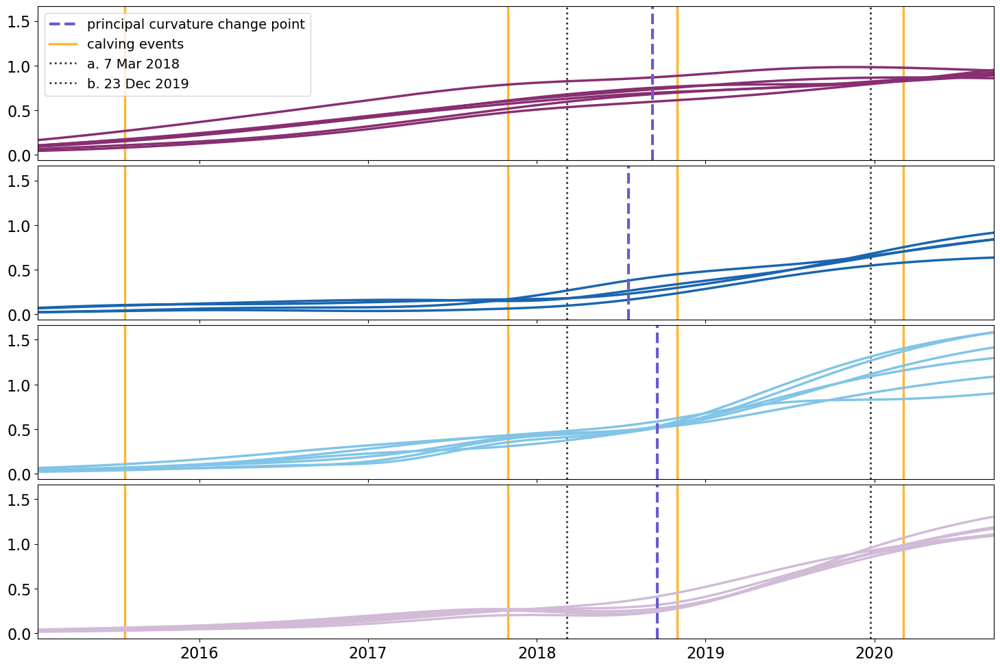

In [25]:
# Strain rate times series at selected sampling locations

from sklearn.cluster import KMeans

# Define the curve indices for all four groups
group_indices = {
    '#882E72': [(562, 231), (550, 233), (545, 235), (536, 239), (530, 241), (525, 243)],
    '#1965B0': [(483, 262), (488, 262), (493, 262), (498, 262)],
    '#81C4E7': [(510, 259), (515, 259), (520, 259), (525, 259), (530, 259), (535, 259)],
    '#D1BBD7': [(545, 251), (550, 251), (555, 251), (560, 251), (565, 251), (575, 251)]
}

fig, axs = plt.subplots(4, 1, figsize=(18, 12), sharey=True, sharex=True)
plt.subplots_adjust(hspace=0.035)

# Function to find hinge points
def find_hinge_points(time, strain):
    first_derivative = np.gradient(strain, time)
    second_derivative = np.gradient(first_derivative)
    
    # This line of code identifies hinge points as locations where the absolute value of the second derivative
    # exceeds twice the standard deviation of the second derivative across the entire curve. Can edit multiplier
    # to loosen (smaller value) or tighten (larger value) threshold:
    threshold_multiplier = 1.5 # Increase the multiplier to make the criteria tighter
    hinge_points = np.where(np.abs(second_derivative) > np.std(second_derivative) * threshold_multiplier)[0]
    return hinge_points

# Process each group
for ax, (color, indices) in zip(axs, group_indices.items()):
    all_hinge_points = []
    for idx in indices:
        strain_curve = effective_strain[0:200, idx[0], idx[1]]
        hinge_points = find_hinge_points(time[0:200], strain_curve)
        all_hinge_points.extend(hinge_points)
        ax.plot(time[0:200], strain_curve, c=color, linewidth=2.5)
    
    # Use clustering to identify common hinge point locations if hinge points were found
    if len(all_hinge_points) > 0:
        # Reshape hinge points for clustering
        hinge_points_reshaped = np.array(all_hinge_points).reshape(-1, 1)
        # Assuming we want to identify up to 2 clusters of hinge points
        kmeans = KMeans(n_clusters=min(1, len(hinge_points_reshaped)), random_state=0).fit(hinge_points_reshaped)
        cluster_centers = kmeans.cluster_centers_
        for center in cluster_centers:
            ax.axvline(time[int(center[0])], color='slateblue', linestyle='--', linewidth=3,label='principal curvature change point')
            print(time[int(center[0])])


# Set common properties and add legends
for ax in axs:
    axs[0].legend(fontsize=14, loc='upper left')
    ax.tick_params(axis='y', labelsize=16)
    ax.tick_params(axis='x', labelsize=16)
    ax.set_xlim([time[0], time[199]])
    ax.axvline(2015.56, c='orange', alpha=0.8, linewidth=2.5, label='calving events',zorder=-1)
    ax.axvline(2017.83, c='orange', alpha=0.8, linewidth=2.5,zorder=-1)
    ax.axvline(2018.83, c='orange', alpha=0.8, linewidth=2.5,zorder=-1)
    ax.axvline(2020.17, c='orange', alpha=0.8, linewidth=2.5,zorder=-1)
    ax.axvline(2018.178, c='k', alpha=0.8, linestyle=':',linewidth=2,zorder=-1, label= 'a. 7 Mar 2018')
    ax.axvline(2019.975, c='k', alpha=0.8, linestyle=':',linewidth=2,zorder=-1, label = 'b. 23 Dec 2019')

#plt.show()

#plt.savefig('strainrate_evolution_hingepoint.png', format='png', dpi=400)

# Supplement figs
Largely uses same code, uncomment to run

### Here we want to test same idea as above but instead of identifying one pivotal moment in time, we allow for four clusters (matching the number of calving events in this time period) to identify the four major strain rate changes in slope 

/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.wa

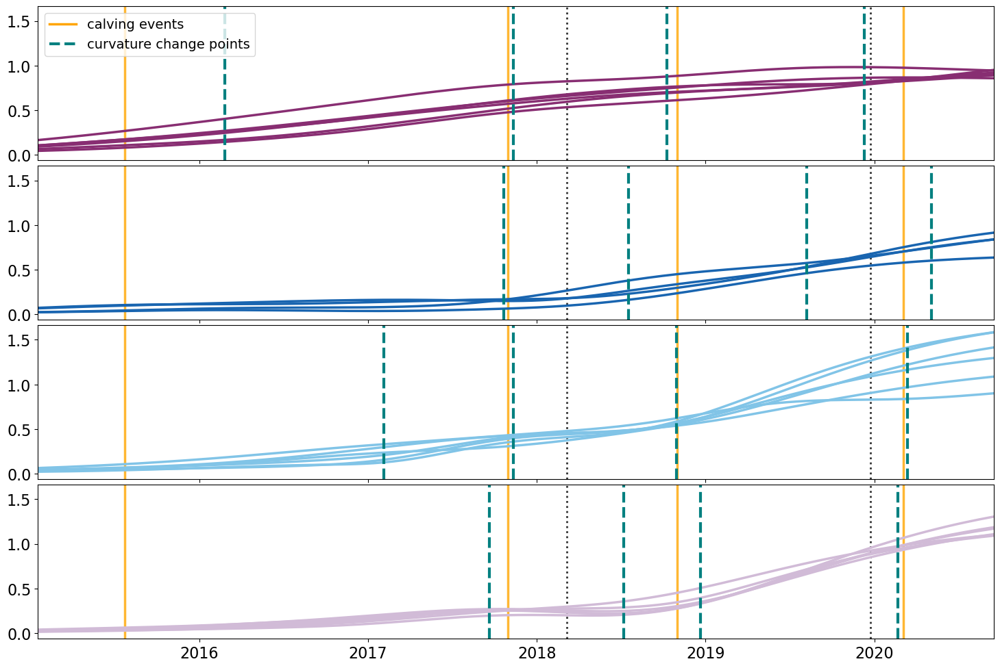

In [10]:
# fig, axs = plt.subplots(4, 1, figsize=(18, 12), sharey=True, sharex=True)
# plt.subplots_adjust(hspace=0.035)

# # Function to find hinge points
# def find_hinge_points(time, strain):
#     first_derivative = np.gradient(strain, time)
#     second_derivative = np.gradient(first_derivative)
    
#     # This line of code identifies hinge points as locations where the absolute value of the second derivative
#     # exceeds twice the standard deviation of the second derivative across the entire curve. Can edit multiplier
#     # to loosen (smaller value) or tighten (larger value) threshold:
#     threshold_multiplier = 1 # Increase the multiplier to make the criteria tighter
#     hinge_points = np.where(np.abs(second_derivative) > np.std(second_derivative) * threshold_multiplier)[0]
#     return hinge_points

# # Process each group
# for ax, (color, indices) in zip(axs, group_indices.items()):
#     all_hinge_points = []
#     for idx in indices:
#         strain_curve = effective_strain[0:200, idx[0], idx[1]]
#         hinge_points = find_hinge_points(time[0:200], strain_curve)
#         all_hinge_points.extend(hinge_points)
#         ax.plot(time[0:200], strain_curve, c=color, linewidth=2.5)
    
#     # Use clustering to identify common hinge point locations if hinge points were found
#     if len(all_hinge_points) > 0:
#         # Reshape hinge points for clustering
#         hinge_points_reshaped = np.array(all_hinge_points).reshape(-1, 1)
#         # Assuming we want to identify up to 2 clusters of hinge points
#         kmeans = KMeans(n_clusters=min(4, len(hinge_points_reshaped)), random_state=0).fit(hinge_points_reshaped)
#         cluster_centers = kmeans.cluster_centers_
#         for center in cluster_centers:
#             ax.axvline(time[int(center[0])], color='teal', linestyle='--', linewidth=3,label='curvature change points')
            
# # Set common properties and add legends
# for ax in axs:
#     axs[0].legend(fontsize=14, loc='upper left')
#     ax.tick_params(axis='y', labelsize=16)
#     ax.tick_params(axis='x', labelsize=16)
#     ax.set_xlim([time[0], time[199]])
#     ax.axvline(2015.56, c='orange', alpha=0.8, linewidth=2.5, label='calving events',zorder=-1)
#     ax.axvline(2017.83, c='orange', alpha=0.8, linewidth=2.5,zorder=-1)
#     ax.axvline(2018.83, c='orange', alpha=0.8, linewidth=2.5,zorder=-1)
#     ax.axvline(2020.17, c='orange', alpha=0.8, linewidth=2.5,zorder=-1)
#     ax.axvline(2018.178, c='k', alpha=0.8, linestyle=':',linewidth=2,zorder=-1, label= 'a. 7 Mar 2018')
#     ax.axvline(2019.975, c='k', alpha=0.8, linestyle=':',linewidth=2,zorder=-1, label = 'b. 23 Dec 2019')
    
    
# legend_added = False  # Flag to track if the custom legend entry has been added

# # Other parts of your code remain unchanged...

# # After the loop that processes each group, manually add the legend for calving events outside the loop
# custom_legend_entries = [plt.Line2D([0], [0], color='orange', lw=2.5, label='calving events'),
#                          plt.Line2D([0], [0], color='teal', linestyle='--', lw=3, label='curvature change points')]
# axs[0].legend(handles=custom_legend_entries, fontsize=14, loc='upper left')

# #plt.show()
# #plt.savefig('strainrate_evolution_hingepointk=4.png', format='png', dpi=400)

#### Next, here are just some figs to help visualize the methods we used, decsribed in the manucript.
First, we identfiy hinge points of the second time derivative of each strain rate time series.
<br>
Then, we use a Kmeans clustering algorithm to identify the unique most important moment in time when the curvature collectively changed across these points, identified independently across the four regions (colors shown here in each subplot)

## Visualize effective strain rate and first and time second derivatives

/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.wa

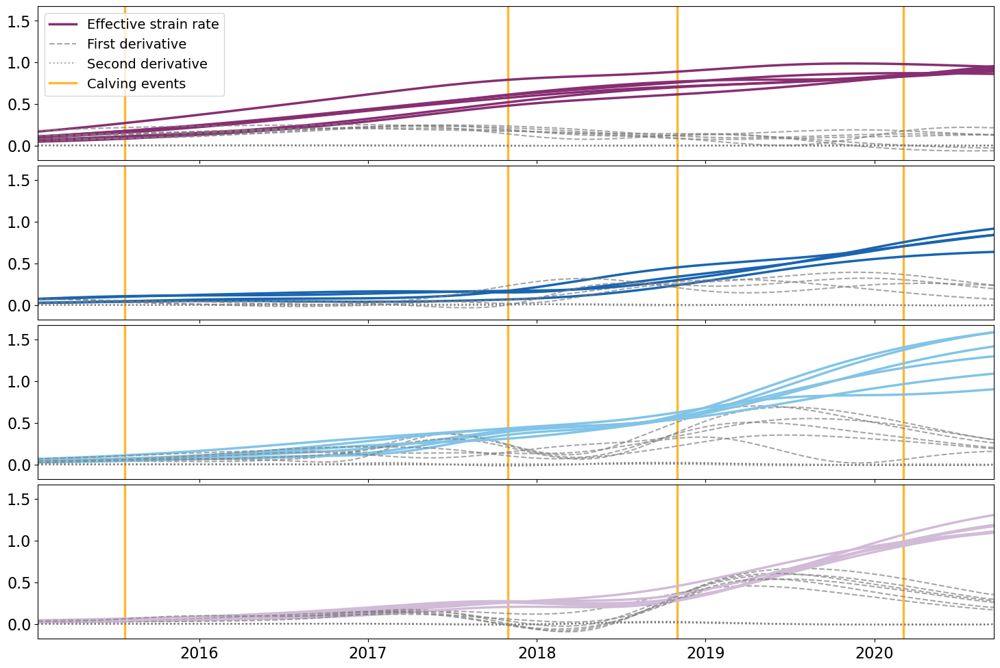

In [20]:
# fig, axs = plt.subplots(4, 1, figsize=(18, 12), sharey=True, sharex=True)
# plt.subplots_adjust(hspace=0.035)

# # Function to find hinge points
# def find_hinge_points(time, strain):
#     first_derivative = np.gradient(strain, time)
#     second_derivative = np.gradient(first_derivative)
    
#     # Identify hinge points where second derivative exceeds threshold
#     threshold_multiplier = 1.5
#     hinge_points = np.where(np.abs(second_derivative) > np.std(second_derivative) * threshold_multiplier)[0]
    
#     return first_derivative, second_derivative, hinge_points

# # Create a dictionary to keep track of added legend labels
# legend_labels = {
#     'Effective strain rate': False,
#     'First derivative': False,
#     'Second derivative': False
# }

# # Process each group
# for ax, (color, indices) in zip(axs, group_indices.items()):
#     all_hinge_points = []
    
#     for idx in indices:
#         strain_curve = effective_strain[0:200, idx[0], idx[1]]
#         first_derivative, second_derivative, hinge_points = find_hinge_points(time[0:200], strain_curve)
        
#         # Plot the effective strain curve
#         ax.plot(time[0:200], strain_curve, c=color, linewidth=2.5, label='Effective strain rate' if not legend_labels['Effective strain rate'] else "")
#         legend_labels['Effective strain rate'] = True
        
#         # Plot the first derivative on the same axis
#         ax.plot(time[0:200], first_derivative, c='gray', linestyle='--', label='First derivative' if not legend_labels['First derivative'] else "", alpha=0.7)
#         legend_labels['First derivative'] = True
        
#         # Plot the second derivative on the same axis
#         ax.plot(time[0:200], second_derivative, c='gray', linestyle=':', label='Second derivative' if not legend_labels['Second derivative'] else "", alpha=0.7)
#         legend_labels['Second derivative'] = True

#         all_hinge_points.extend(hinge_points)
    
#     # Use clustering to identify common hinge point locations if hinge points were found
#     if len(all_hinge_points) > 0:
#         hinge_points_reshaped = np.array(all_hinge_points).reshape(-1, 1)
#         kmeans = KMeans(n_clusters=min(1, len(hinge_points_reshaped)), random_state=0).fit(hinge_points_reshaped)
#         cluster_centers = kmeans.cluster_centers_
        
# #         for center in cluster_centers:
# #             ax.axvline(time[int(center[0])], color='slateblue', linestyle='--', linewidth=3, label='Principal Curvature Change Point')
# #             print(time[int(center[0])])

# # Set common properties and add legends
# for ax in axs:
#     axs[0].legend(fontsize=14, loc='upper left')
#     ax.tick_params(axis='y', labelsize=16)
#     ax.tick_params(axis='x', labelsize=16)
#     ax.set_xlim([time[0], time[199]])
#     ax.axvline(2015.56, c='orange', alpha=0.8, linewidth=2.5, label='Calving events', zorder=-1)
#     ax.axvline(2017.83, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     ax.axvline(2018.83, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     ax.axvline(2020.17, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     #ax.axvline(2018.178, c='k', alpha=0.8, linestyle=':', linewidth=2, zorder=-1, label='a. 7 Mar 2018')
#     #ax.axvline(2019.975, c='k', alpha=0.8, linestyle=':', linewidth=2, zorder=-1, label='b. 23 Dec 2019')

# # plt.show()
# #plt.savefig('strainrate_evolution_hingepointv2.png', format='png', dpi=400)


## Now only first and second time derivative

/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.wa

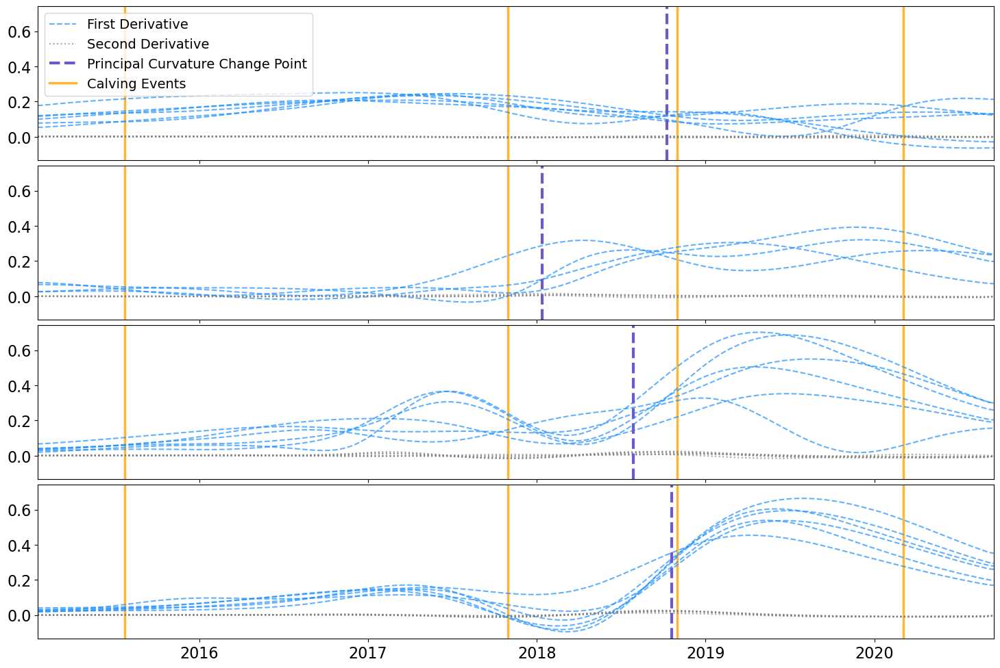

In [15]:
# fig, axs = plt.subplots(4, 1, figsize=(18, 12), sharey=True, sharex=True)
# plt.subplots_adjust(hspace=0.035)

# # Function to find hinge points
# def find_hinge_points(time, strain):
#     first_derivative = np.gradient(strain, time)
#     second_derivative = np.gradient(first_derivative)
    
#     # Identify hinge points where second derivative exceeds threshold
#     threshold_multiplier = 1.5
#     hinge_points = np.where(np.abs(second_derivative) > np.std(second_derivative) * threshold_multiplier)[0]
    
#     return first_derivative, second_derivative, hinge_points

# # Create a dictionary to keep track of added legend labels
# legend_labels = {
#     'First Derivative': False,
#     'Second Derivative': False
# }

# # Process each group
# for ax, (color, indices) in zip(axs, group_indices.items()):
    
#     for idx in indices:
#         strain_curve = effective_strain[0:200, idx[0], idx[1]]
#         first_derivative, second_derivative, _ = find_hinge_points(time[0:200], strain_curve)

#         # Plot the first derivative on the axis
#         ax.plot(time[0:200], first_derivative, c='dodgerblue', linestyle='--', 
#                 label='First Derivative' if not legend_labels['First Derivative'] else "", alpha=0.7)
#         legend_labels['First Derivative'] = True
        
#         # Plot the second derivative on the axis
#         ax.plot(time[0:200], second_derivative, c='gray', linestyle=':', 
#                 label='Second Derivative' if not legend_labels['Second Derivative'] else "", alpha=0.7)
#         legend_labels['Second Derivative'] = True
    
#     # Use clustering to identify common hinge point locations
#     # This section remains unchanged from the original code
#     if len(_) > 0:
#         hinge_points_reshaped = np.array(_).reshape(-1, 1)
#         kmeans = KMeans(n_clusters=min(1, len(hinge_points_reshaped)), random_state=0).fit(hinge_points_reshaped)
#         cluster_centers = kmeans.cluster_centers_

#         for center in cluster_centers:
#             ax.axvline(time[int(center[0])], color='slateblue', linestyle='--', linewidth=3, 
#                        label='Principal Curvature Change Point')

# # Set common properties and add legends
# for ax in axs:
#     axs[0].legend(fontsize=14, loc='upper left')
#     ax.tick_params(axis='y', labelsize=16)
#     ax.tick_params(axis='x', labelsize=16)
#     ax.set_xlim([time[0], time[199]])
#     ax.axvline(2015.56, c='orange', alpha=0.8, linewidth=2.5, label='Calving Events', zorder=-1)
#     ax.axvline(2017.83, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     ax.axvline(2018.83, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     ax.axvline(2020.17, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     #ax.axvline(2018.178, c='k', alpha=0.8, linestyle=':', linewidth=2, zorder=-1, label='a. 7 Mar 2018')
#     #ax.axvline(2019.975, c='k', alpha=0.8, linestyle=':', linewidth=2, zorder=-1, label='b. 23 Dec 2019')

# #plt.show()
# # plt.savefig('strainrate_evolution_hingepoint.png', format='png', dpi=400)


## Now only second time derivative of effective strain rate, with hinge points and principal curvature change points

/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/anaconda3/envs/polyarea/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.wa

2018.6864035350043
2018.5440622154113
2018.7148717989228
2018.7148717989228


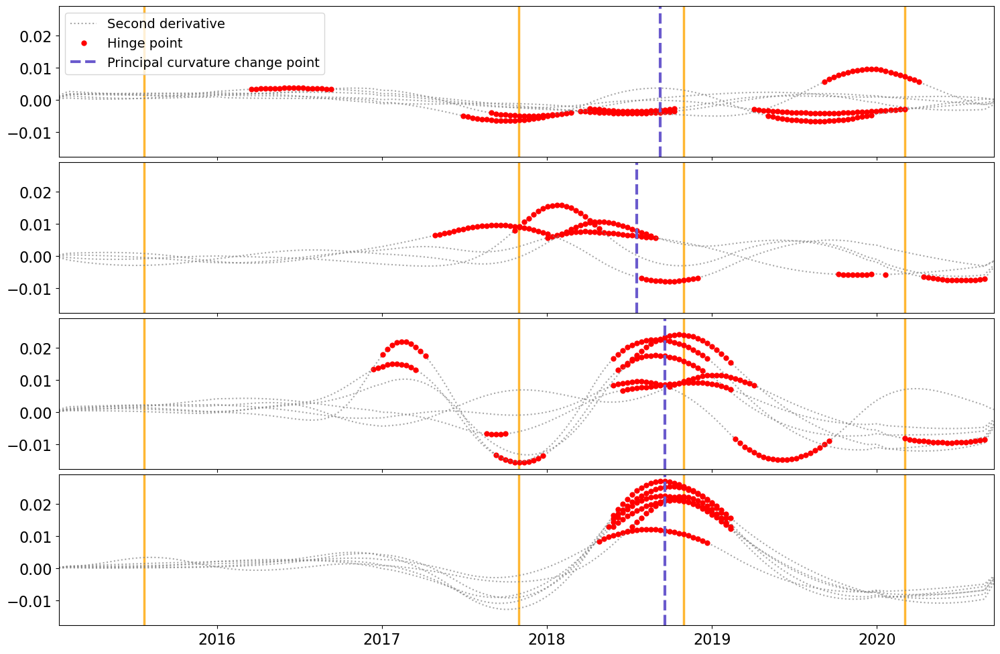

In [23]:
# fig, axs = plt.subplots(4, 1, figsize=(18, 12), sharey=True, sharex=True)
# plt.subplots_adjust(hspace=0.035)

# # Function to find hinge points
# def find_hinge_points(time, strain):
#     first_derivative = np.gradient(strain, time)
#     second_derivative = np.gradient(first_derivative)

#     # Identify hinge points where second derivative exceeds threshold
#     threshold_multiplier = 1.5
#     hinge_points = np.where(np.abs(second_derivative) > np.std(second_derivative) * threshold_multiplier)[0]

#     return first_derivative, second_derivative, hinge_points

# # Process each group
# for ax, (color, indices) in zip(axs, group_indices.items()):
#     all_hinge_points = []
    
#     for idx in indices:
#         strain_curve = effective_strain[0:200, idx[0], idx[1]]
#         first_derivative, second_derivative, hinge_points = find_hinge_points(time[0:200], strain_curve)

#         # Plot the second derivative curve
#         ax.plot(time[0:200], second_derivative, c='gray', linestyle=':', label='Second derivative', alpha=0.7)

#         # Plot individual hinge points
#         for i, hinge_point in enumerate(hinge_points):
#             ax.plot(time[hinge_point], second_derivative[hinge_point], 'ro', markersize=5, 
#                     label='Hinge point' if i == 0 else "")  # Only label the first hinge point

#         all_hinge_points.extend(hinge_points)
    
#     # Use clustering to identify common hinge point locations if hinge points were found
#     if len(all_hinge_points) > 0:
#         hinge_points_reshaped = np.array(all_hinge_points).reshape(-1, 1)
#         kmeans = KMeans(n_clusters=min(1, len(hinge_points_reshaped)), random_state=0).fit(hinge_points_reshaped)
#         cluster_centers = kmeans.cluster_centers_

#         for center in cluster_centers:
#             ax.axvline(time[int(center[0])], color='slateblue', linestyle='--', linewidth=3, 
#                        label='Principal curvature change point')
#             print(time[int(center[0])])

# # Set common properties and add legends
# # Ensure only the first entry of each type is shown
# handles, labels = ax.get_legend_handles_labels()
# by_label = dict(zip(labels, handles))
# axs[0].legend(by_label.values(), by_label.keys(), fontsize=14, loc='upper left')

# for ax in axs:
#     ax.tick_params(axis='y', labelsize=16)
#     ax.tick_params(axis='x', labelsize=16)
#     ax.set_xlim([time[0], time[199]])
#     ax.axvline(2015.56, c='orange', alpha=0.8, linewidth=2.5, label='Calving events', zorder=-1)
#     ax.axvline(2017.83, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     ax.axvline(2018.83, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     ax.axvline(2020.17, c='orange', alpha=0.8, linewidth=2.5, zorder=-1)
#     #ax.axvline(2018.178, c='k', alpha=0.8, linestyle=':', linewidth=2, zorder=-1, label='a. 7 Mar 2018')
#     #ax.axvline(2019.975, c='k', alpha=0.8, linestyle=':', linewidth=2, zorder=-1, label='b. 23 Dec 2019')


# #plt.show()
# #plt.savefig('secondderiv.png', format='png', dpi=400)



## More supplement code
## Load coastline shapefiles

In [63]:
# coast2017 = gpd.read_file('../deformation tiffs (qgis)/digitization/20171013coastline.shp')
# coast2017 = coast2017.to_crs("epsg:4326")

# coast2018 = gpd.read_file('../deformation tiffs (qgis)/digitization/20181118coastline.shp')
# coast2018 = coast2018.to_crs("epsg:4326")

# coast2020 = gpd.read_file('../deformation tiffs (qgis)/digitization/20200211coastline.shp')
# coast2020 = coast2020.to_crs("epsg:4326")

In [61]:
# # sentinel2: blue (B2), green (B3), red (B4)

# red_path= '../PIG_sentinel2/20180307/T14CMB_20180307T145249_B04.jp2'
# green_path= '../PIG_sentinel2/20180307/T14CMB_20180307T145249_B03.jp2'
# blue_path= '../PIG_sentinel2/20180307/T14CMB_20180307T145249_B02.jp2'

# # Normalize each band independently
# def normalize_band(band):
#     band_min = band.min()
#     band_max = band.max()
#     return ((band - band_min) / (band_max - band_min) * 255).astype('uint8')

# # Open the single band
# with rasterio.open(red_path) as rr, rasterio.open(green_path) as gg, rasterio.open(blue_path) as bb:
#     # Read each band
#     red_band = rr.read(1)
#     green_band = gg.read(1)
#     blue_band = bb.read(1)

#     # Normalize each band
#     red_band_normalized = normalize_band(red_band)
#     green_band_normalized = normalize_band(green_band)
#     blue_band_normalized = normalize_band(blue_band)

#     # Stack the bands into an RGB image
#     rgb_image = np.dstack((red_band_normalized, green_band_normalized, blue_band_normalized))

#     # Get the geospatial transformation matrix
#     transform = file.transform  # Assumes all bands share the same transform

#     # Specify the South Polar Stereographic projection
#     projection = ccrs.SouthPolarStereo(central_longitude=-99.0)  #get central lon from metadata

#     # Calculate the geographic coordinates of the four corners
#     width, height = file.width, file.height
#     upper_left = transform * (0, 0)
#     upper_right = transform * (width, 0)
#     lower_left = transform * (0, height)
#     lower_right = transform * (width, height)

#     # Get corners in the desired projection
#     ul_lon, ul_lat = projection.transform_point(upper_left[0], upper_left[1], file.crs)
#     ur_lon, ur_lat = projection.transform_point(upper_right[0], upper_right[1], file.crs)
#     ll_lon, ll_lat = projection.transform_point(lower_left[0], lower_left[1], file.crs)
#     lr_lon, lr_lat = projection.transform_point(lower_right[0], lower_right[1], file.crs)


In [62]:
# # Apply higher contrast stretching to each color channel
# # It calculates the 1st and 99th percentiles of pixel values in each channel and stretches 
# # the pixel values to cover the full range between these percentiles
# def contrast_stretching(image):
#     p1, p95 = np.percentile(image, (1, 95))  # Adjust the percentiles to control the contrast
#     return exposure.rescale_intensity(image, in_range=(p1, p95))

# red_band_stretched = contrast_stretching(rgb_image[:, :, 0])
# green_band_stretched = contrast_stretching(rgb_image[:, :, 1])
# blue_band_stretched = contrast_stretching(rgb_image[:, :, 2])

# # Apply gamma correction to each color channel
# # It applies a power-law transformation to the pixel values, effectively adjusting the brightness of the image.
# #A gamma value of 3.5 is used in the code, which has the effect of darkening shadows and enhancing mid-tones and highlights.
# def gamma_correction(image, gamma=2):
#     return exposure.adjust_gamma(image, gamma)

# red_band_corrected = gamma_correction(red_band_stretched)
# green_band_corrected = gamma_correction(green_band_stretched)
# blue_band_corrected = gamma_correction(blue_band_stretched)

# # Stack the corrected channels back into an RGB image
# rgb_image_corrected = np.stack((red_band_corrected, green_band_corrected, blue_band_corrected), axis=-1)

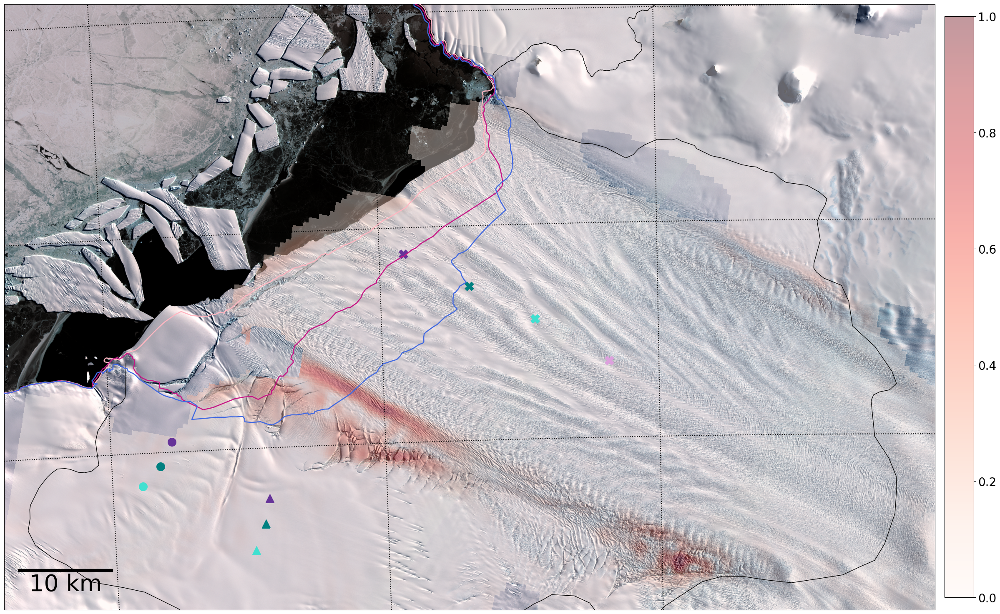

In [66]:
# #llcrnrlat=-75.4;urcrnrlat=-74.9;llcrnrlon=-102;urcrnrlon=-99.5
# llcrnrlat=-75.34;urcrnrlat=-74.8;llcrnrlon=-102.3;urcrnrlon=-99
# # Create the plot with the specified CRS
# fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': projection})

# # Set the extent
# ax.set_extent([llcrnrlon, urcrnrlon, llcrnrlat, urcrnrlat], crs=ccrs.PlateCarree())

# # Display the Landsat image with improved brightness, higher contrast, and gamma correction
# data = ax.imshow(rgb_image_corrected, extent=(ll_lon, ur_lon, ll_lat, ur_lat), origin='upper',transform=projection)
# strain = ax.imshow(effective_strain[113,:,:], extent=(ll_lon_strain, ur_lon_strain, ll_lat_strain, ur_lat_strain),vmin =0, vmax = 1, cmap = 'Reds',transform=projection2,alpha=0.4)

# # Add gridlines with the correct orientation
# # gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, xlocs=[-102, -101, -100, -99], ylocs=[-75.5, -75, -74, -73, -72], color='k', linestyle=':')
# gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=False, xlocs=[-102, -101, -100, -99], ylocs=[-74.8, -75, -75.2, -74, -73, -72], color='k', linestyle=':',linewidth=1.5)
# #gl.top_labels = gl.right_labels = False  # Turn off top and right labels

# # coastlines
# ax.add_geometries(coast2017['geometry'], crs=ccrs.PlateCarree(),facecolor='None', edgecolor='lightpink',zorder=5,label='13 Oct 2017 coastline',linewidth=1.8)
# ax.add_geometries(coast2018['geometry'], crs=ccrs.PlateCarree(),facecolor='None', edgecolor='mediumvioletred',zorder=5,label='18 Nov 2018 coastline',linewidth=1.8)
# ax.add_geometries(coast2020['geometry'], crs=ccrs.PlateCarree(),facecolor='None', edgecolor='royalblue',zorder=5,label='11 Feb 2020 coastline',linewidth=1.8)
# # grounding line
# ax.add_geometries(GL['geometry'], crs=ccrs.PlateCarree(),facecolor='None', edgecolor='k',zorder=3)

# #south shelf west channel
# ax.scatter(-101.7774,-75.1903, transform=ccrs.PlateCarree(), s=200, c='rebeccapurple',zorder=4)
# ax.scatter(-101.8234,-75.2128, transform=ccrs.PlateCarree(), s=200, c='teal',zorder=4)
# ax.scatter(-101.8903,-75.2305, transform=ccrs.PlateCarree(), s=200, c='turquoise',zorder=4)

# #south shelf east channel
# ax.scatter(-101.4292,-75.247, transform=ccrs.PlateCarree(), s=200, marker= '^',c='rebeccapurple',zorder=4)
# ax.scatter(-101.448,-75.2704, transform=ccrs.PlateCarree(), s=200, marker= '^',c='teal',zorder=4)
# ax.scatter(-101.4868,-75.2948, transform=ccrs.PlateCarree(), s=200, marker= '^',c='turquoise',zorder=4)

# #main trunk
# ax.scatter(-100.9137,-75.0245, transform=ccrs.PlateCarree(), s=230, marker= 'X',c='rebeccapurple',zorder=4)
# ax.scatter(-100.6787,-75.0561, transform=ccrs.PlateCarree(), s=230, marker= 'X',c='teal',zorder=4)
# ax.scatter(-100.4455,-75.0883, transform=ccrs.PlateCarree(), s=230, marker= 'X',c='turquoise',zorder=4)
# ax.scatter(-100.18,-75.1287, transform=ccrs.PlateCarree(), s=230, marker= 'X',c='plum',zorder=4)

# # Colorbar
# cb = plt.colorbar(strain, fraction=0.03, pad=0.01)
# #cb.set_label('Strain', fontsize=40, labelpad=1)
# # Increase tick label size
# cb.ax.tick_params(labelsize=20) 

# fontprops = fm.FontProperties(size=40)
# scalebar = AnchoredSizeBar(ax.transData,
#                            10000, '10 km', 'lower left',
#                            pad=0.5,
#                            color='k',
#                            frameon=False,
#                            size_vertical=250,
#                            fill_bar=True,
#                            sep=3.5,
#                            fontproperties=fontprops)
# ax.add_artist(scalebar)

# # Turn off axis
# #ax.axis('off')

# #plt.show()

# #plt.savefig('supp_velocitytimeseries.png', format='png', dpi=400)